In [ ]:
%tensorflow_version 2.x
import tensorflow as tf 

!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

assert len(tf.config.list_physical_devices('GPU')) > 0

In [ ]:

songs = mdl.lab1.load_training_data()


example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


In [ ]:
type(songs)

list

In [ ]:

mdl.lab1.play_song(example_song)

In [ ]:

songs_joined = "\n\n".join(songs) 


vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [ ]:
  
char2idx = {u:i for i, u in enumerate(vocab)}

idx2char = np.array(vocab)

In [ ]:


def vectorize_string(string):
  vectorized_output = np.array([char2idx[i] for i in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [ ]:
vectorized_songs.shape , (np.array(vectorized_songs)).ndim

((200679,), 1)

In [ ]:
vectorized_songs.shape[0] - 1

200678

In [ ]:
np.random.choice(vectorized_songs.shape[0]-1-10, 5)

array([124643,   3658, 170097, 142282, 180076])

In [ ]:

def get_batch(vectorized_songs, seq_length, batch_size):
  n = vectorized_songs.shape[0] - 1
  idx = np.random.choice(n-seq_length, batch_size)

  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]
  print(np.array(input_batch).shape)
  output_batch = [vectorized_songs[i+1: i+seq_length+1] for i in idx]

  
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch




In [ ]:
x, y = get_batch(vectorized_songs,10,5)
x, y , x.shape

(5, 10)


(array([[62, 60, 56, 61,  1, 62, 60, 59, 62, 82],
        [ 1, 64, 59, 22, 59, 58,  9, 74, 60, 75],
        [30, 14, 82, 58, 14,  1, 58, 14,  1, 58],
        [ 2,  0, 56, 15,  1, 60, 58, 60, 82, 60],
        [32, 27, 32, 82, 32, 14, 27, 59,  1, 60]]),
 array([[60, 56, 61,  1, 62, 60, 59, 62, 82,  2],
        [64, 59, 22, 59, 58,  9, 74, 60, 75, 59],
        [14, 82, 58, 14,  1, 58, 14,  1, 58, 14],
        [ 0, 56, 15,  1, 60, 58, 60, 82, 60, 59],
        [27, 32, 82, 32, 14, 27, 59,  1, 60, 61]]),
 (5, 10))

In [ ]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

(1, 5)
Step   0
  input: 31 ('F')
  expected output: 1 (' ')
Step   1
  input: 1 (' ')
  expected output: 29 ('D')
Step   2
  input: 29 ('D')
  expected output: 30 ('E')
Step   3
  input: 30 ('E')
  expected output: 31 ('F')
Step   4
  input: 31 ('F')
  expected output: 26 ('A')


In [ ]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [ ]:


'''TODO: Add LSTM and Dense layers to define the RNN model using the Sequential API.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    
    LSTM(rnn_units=rnn_units),

    tf.keras.layers.Dense(units = vocab_size, activation = "relu")
  ])

  return model

model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

(32, 100)
Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


In [ ]:
y.shape

(32, 100)

In [ ]:
tf.random.normal(shape = [2,3,2])

<tf.Tensor: shape=(2, 3, 2), dtype=float32, numpy=
array([[[-0.599076  ,  0.09443258],
        [ 0.48150125, -0.9111264 ],
        [ 1.6220193 , -0.3021057 ]],

       [[ 0.4810692 ,  1.6564502 ],
        [-0.71341884,  0.7230322 ],
        [-0.49996305,  0.43027592]]], dtype=float32)>

In [ ]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([41, 13, 63, 65, 63, 82, 73,  9, 68, 76, 82, 32, 51, 54, 73, 16, 73,
       10, 47,  1, 52, 76, 79,  0, 36, 56, 54, 65, 35, 21, 26,  9, 20, 69,
       18, 24, 12, 61, 57, 80, 29, 32, 17, 52, 56, 11, 26, 21, 43, 75, 29,
       78, 32, 43, 53, 44, 21,  4, 39, 66, 35,  8, 65, 18, 24, 38, 48,  5,
       17, 22, 11,  4, 78, 34, 39, 56, 24, 66, 50, 66, 21, 32, 25, 60, 77,
       19, 71, 14, 13, 61, 75, 56, 33, 80, 82, 77, 17, 48, 35, 79])

In [ ]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'ABc d2ef|g3e dBGB|c2ec B2dB|AGAB GED|!\n[1 E|GABc d2ef|g3e dBGB|c2ec B2dB|AGAB G3:|!\n[2 f|gfgd efge|d'

Next Char Predictions: 
 "P1hjh|r-mu|GZ^r4r.V [ux\nKa^jJ9A-8n6=0fbyDG5[a/A9RtDwGR]S9#NkJ,j6=MW'5:/#wINa=kYk9G>ev7p21ftaHy|v5WJx"


In [ ]:
idx2char[sampled_indices]

array(['P', '1', 'h', 'j', 'h', '|', 'r', '-', 'm', 'u', '|', 'G', 'Z',
       '^', 'r', '4', 'r', '.', 'V', ' ', '[', 'u', 'x', '\n', 'K', 'a',
       '^', 'j', 'J', '9', 'A', '-', '8', 'n', '6', '=', '0', 'f', 'b',
       'y', 'D', 'G', '5', '[', 'a', '/', 'A', '9', 'R', 't', 'D', 'w',
       'G', 'R', ']', 'S', '9', '#', 'N', 'k', 'J', ',', 'j', '6', '=',
       'M', 'W', "'", '5', ':', '/', '#', 'w', 'I', 'N', 'a', '=', 'k',
       'Y', 'k', '9', 'G', '>', 'e', 'v', '7', 'p', '2', '1', 'f', 't',
       'a', 'H', 'y', '|', 'v', '5', 'W', 'J', 'x'], dtype='<U1')

In [ ]:

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels,logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred) 

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4190397


In [ ]:

num_training_iterations = 2000 
batch_size = 4  
seq_length = 100  
learning_rate = 5e-3  

 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024 

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

In [ ]:
model.trainable_variables

[<tf.Variable 'embedding/embeddings:0' shape=(83, 256) dtype=float32, numpy=
 array([[ 0.01684297,  0.00385432, -0.03902626, ..., -0.04144893,
         -0.04960644, -0.0071478 ],
        [-0.03335197,  0.03830643, -0.00180034, ...,  0.03026695,
          0.04199301, -0.04353976],
        [-0.04979075, -0.04151319,  0.023035  , ...,  0.03930844,
         -0.01661695, -0.02962684],
        ...,
        [-0.00876522, -0.03680582,  0.04730728, ..., -0.0391661 ,
         -0.04639783, -0.03249298],
        [ 0.02789767, -0.0326255 ,  0.00021777, ...,  0.01584092,
         -0.03633064, -0.02034992],
        [-0.03971102,  0.00292708, -0.03938346, ...,  0.01655466,
          0.03611981,  0.00303286]], dtype=float32)>,
 <tf.Variable 'lstm/lstm_cell/kernel:0' shape=(256, 4096) dtype=float32, numpy=
 array([[ 0.0196138 ,  0.00192118, -0.00151705, ...,  0.00896577,
         -0.01304331, -0.01505105],
        [ 0.00467341,  0.00644579,  0.0015263 , ..., -0.0174528 ,
         -0.028269  ,  0.0115792

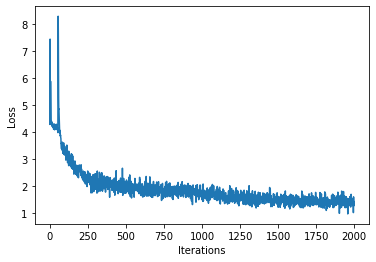

100%|██████████| 2000/2000 [00:54<00:00, 36.77it/s]


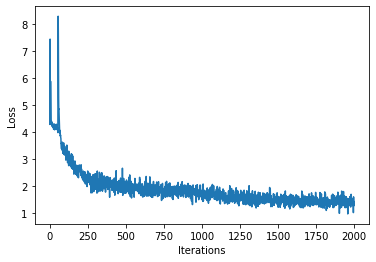

In [ ]:

model = build_model(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    rnn_units=rnn_units,
    batch_size=batch_size
    )


optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate, name = "Adam")

@tf.function
def train_step(x, y): 
  with tf.GradientTape() as tape:
  
    y_hat = model(x)
  
    loss = compute_loss(y,y_hat)

  
  grads = tape.gradient(loss, model.trainable_variables)
  
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss


history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() 

for iter in tqdm(range(num_training_iterations)):

  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  history.append(loss.numpy().mean())
  plotter.plot(history)

  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
model.save_weights(checkpoint_prefix)


In [ ]:
model = build_model(vocab_size=vocab_size,
                    embedding_dim = embedding_dim,
                    rnn_units = rnn_units,
                    batch_size=1)

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_2 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_2 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [ ]:

def generate_text(model, start_string, generation_length=1000):

  
  input_eval = [char2idx[i] for i in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  
  text_generated = []

  
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      
      predictions = model(input_eval)
      
      predictions = tf.squeeze(predictions, 0)
      
      
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      
      input_eval = tf.expand_dims([predicted_id], 0)
      
      
      text_generated.append(idx2char[predicted_id])
    
  return (start_string + ''.join(text_generated))

In [ ]:
generated_text = generate_text(model, start_string="X", generation_length=100000)

100%|██████████| 100000/100000 [09:53<00:00, 168.48it/s]


In [ ]:


generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  
  waveform = mdl.lab1.play_song(song)

   
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 321 songs in text
Generated song 153
